# <center>**Exploring Ebay Used Vehicles Data**</center>

## **Background**
This project will analyze used vehicles data from eBay Kleinanzeigen (eBay Germany). The dataset was originally scraped (March, 5, 2016 through April, 7, 2016) and uploaded to [Kaggle](https://www.kaggle.com/orgesleka/used-cars-database/data). The data contains several variables describing features about the vehicle in the ad (e.g., model, gas type, kilometers driven, etc), and variables about the website (e.g., type of seller, type of listing, number of pictures in the ad, etc). Here is the data dictionary associated with the data:


- ```dateCrawled```- When this ad was first crawled. All field-values are taken from this date.
- ```name``` - Name of the car.
- ```seller``` - Whether the seller is private or a dealer.
- ```offerType``` - The type of listing
- ```price``` - The price on the ad to sell the car.
- ```abtest``` - Whether the listing is included in an A/B test.
- ```vehicleType``` - The vehicle Type.
- ```yearOfRegistration``` - The year in which which year the car was first registered.
- ```gearbox``` - The transmission type.
- ```powerPS``` - The power of the car in PS.
- ```model``` - The car model name.
- ```kilometer``` - How many kilometers the car has driven.
- ```monthOfRegistration``` - The month in which which year the car was first registered.
- ```fuelType``` - What type of fuel the car uses.
- ```brand``` - The brand of the car.
- ```notRepairedDamage``` - If the car has a damage which is not yet repaired.
- ```dateCreated``` - The date on which the eBay listing was created.
- ```nrOfPictures``` - The number of pictures in the ad.
- ```postalCode``` - The postal code for the location of the vehicle.
- ```lastSeenOnline``` - When the crawler saw this ad last online.

## **Introduction**

The objective of this project is to conduct exploratory analysis to obtain an understanding of what type of used vehicle ads appear on the website. In doing so, the aim is to identify which vehicles are potentially worth purchasing.

The dataset is a sub-sample of 50,000 records from a larger 370,000 sample which was randomly selected. This project will:
- Clean the dataset;
- Compute descriptive statistics;
- Identify potential candidates vehicles; and
- Conduct a geographic analysis on where one should visit to examine/buy these candidate vehicles.

### **Exploring the nature of the dataset**

In [1]:
# Import packages
import pandas as pd
import numpy as np

# Load dataset - used Latin-1 encoding to avoid errors
autos = pd.read_csv("autos.csv", encoding = "Latin-1")

In [2]:
autos.shape # 50k rows, with 20 columns

(50000, 20)

In [3]:
autos.info()
print("-----")
print(autos.isnull().sum())
print("-----")
autos.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   dateCrawled          50000 non-null  object
 1   name                 50000 non-null  object
 2   seller               50000 non-null  object
 3   offerType            50000 non-null  object
 4   price                50000 non-null  object
 5   abtest               50000 non-null  object
 6   vehicleType          44905 non-null  object
 7   yearOfRegistration   50000 non-null  int64 
 8   gearbox              47320 non-null  object
 9   powerPS              50000 non-null  int64 
 10  model                47242 non-null  object
 11  odometer             50000 non-null  object
 12  monthOfRegistration  50000 non-null  int64 
 13  fuelType             45518 non-null  object
 14  brand                50000 non-null  object
 15  notRepairedDamage    40171 non-null  object
 16  date

,dateCrawled,name,seller,offerType,price,abtest,vehicleType,yearOfRegistration,gearbox,powerPS,model,odometer,monthOfRegistration,fuelType,brand,notRepairedDamage,dateCreated,nrOfPictures,postalCode,lastSeen
0,2016-03-26 17:47:46,Peugeot_807_160_NAVTECH_ON_BOARD,privat,Angebot,"$5,000",control,bus,2004,manuell,158,andere,"150,000km",3,lpg,peugeot,nein,2016-03-26 00:00:00,0,79588,2016-04-06 06:45:54
1,2016-04-04 13:38:56,BMW_740i_4_4_Liter_HAMANN_UMBAU_Mega_Optik,privat,Angebot,"$8,500",control,limousine,1997,automatik,286,7er,"150,000km",6,benzin,bmw,nein,2016-04-04 00:00:00,0,71034,2016-04-06 14:45:08
2,2016-03-26 18:57:24,Volkswagen_Golf_1.6_United,privat,Angebot,"$8,990",test,limousine,2009,manuell,102,golf,"70,000km",7,benzin,volkswagen,nein,2016-03-26 00:00:00,0,35394,2016-04-06 20:15:37
3,2016-03-12 16:58:10,Smart_smart_fortwo_coupe_softouch/F1/Klima/Pan...,privat,Angebot,"$4,350",control,kleinwagen,2007,automatik,71,fortwo,"70,000km",6,benzin,smart,nein,2016-03-12 00:00:00,0,33729,2016-03-15 03:16:28
4,2016-04-01 14:38:50,Ford_Focus_1_6_Benzin_TÜV_neu_ist_sehr_gepfleg...,privat,Angebot,"$1,350",test,kombi,2003,manuell,0,focus,"150,000km",7,benzin,ford,nein,2016-04-01 00:00:00,0,39218,2016-04-01 14:38:50


Note that there are missing values for some variables (e.g., vehicleType, gearbox, model, fuelType, notRepairedDamage). In addition, there are some special characters (e.g., $, km). Lastly, there are some variables that have German words, which make sense as this data was scrapped from a German website.

We can also see some variables have incorrect data types. For example, dateCrawled, dateCreated, and lastSeen are Objects, but should be datetime type. In addition, some variables like price, odometer could become integer type once we remove the special characters.

### **Cleaning the dataset**

In [4]:
# Checked for duplicate rows. There should be no duplicates given each row represents one unique ad. 

duplicate_bool = autos.duplicated()
autos[duplicate_bool]

# Renamed columns to make them easier to work with
autos.columns = autos.columns = ['date_crawled', 'name', 'seller', 'offer_type', 'price', 'ab_test',
       'vehicle_type', 'registration_year', 'gearbox', 'power_ps', 'model',
       'odometer(km)', 'registration_months', 'fuel_type', 'brand',
       'not_repaired_damage', 'ad_created', 'nr_of_pictures', 'postal_code',
       'last_seen']

# Dropped nr_of_pictures column as author of the web scrapper noted that there was a bug in the code that did not capture this data.
autos.drop(["nr_of_pictures"], axis = 1, inplace = True)

In [5]:
# Created mappings and function to translate German words to English.

mappings = {"privat": "private", "gewerblich": "commercial", "Angebot": "bid", "Gesuch": "application", "kleinwagen": 
            "super mini", "kombi":"station wagon", "cabrio": "convertible", "limousine": "sedan", "andere": "other", "manuell": "manual", "automatik": 
            "automatic", "benzin":"gas", "elektro": "electric", "sonstige_auto": "other", "sonstige_autos": "other", "nein": "no", "ja": "yes"}

def super_translate(string):
    if string in mappings:
        return mappings[string]
    else:
        return string

columns_change = ["seller", "offer_type", "vehicle_type", "gearbox", "model", "fuel_type", "brand", "not_repaired_damage"]

autos[columns_change] = autos[columns_change].applymap(super_translate)

In [6]:
# Removed special characters from columns of interest
autos["price"] = autos["price"].str.replace("$", "").str.replace(",", "")
autos["odometer(km)"] = autos["odometer(km)"].str.replace("km", "").str.replace(",", "")

In [7]:
# Changed dtypes of relevant columns

autos = (autos.astype({"price": "int64", "odometer(km)": "int64", "date_crawled": "datetime64[ns]",
                      "ad_created": "datetime64[ns]", "last_seen": "datetime64[ns]"}))
# Note: timestamp portion of datetime is lost for ad_created when casting correct dtype

#### ***Exploring null values and other oddities***

In [8]:
autos["odometer(km)"].value_counts(normalize = True).sort_index(ascending = False)*100

150000    64.848
125000    10.340
100000     4.338
90000      3.514
80000      2.872
70000      2.460
60000      2.328
50000      2.054
40000      1.638
30000      1.578
20000      1.568
10000      0.528
5000       1.934
Name: odometer(km), dtype: float64

In [9]:
autos["price"].value_counts().sort_index()

0           1421
1            156
2              3
3              1
5              2
            ... 
10000000       1
11111111       2
12345678       3
27322222       1
99999999       1
Name: price, Length: 2357, dtype: int64

There are a couple of observations:
1. For the odometer column, the distribution of kilometers is skewed towards the high end. Perhaps this suggests that many of these vehicles are classics, or that people want to sell their vehicles for used parts.
2. For the price column, there are several values that would seem to be too low for a sale (e.g., 1421 records have a value of 0; there are several instances below 60.00). There are also values that are very high for a sale, for example, there is one record that is 99,999,999 million dollars, several above 10 million dollars.

Given that eBay is an auction website, it is possible to have these low values in the price column. When examining records above 350,000, several of these entries appear to be illegitimate entries (e.g., 1234566, 12345678, 1111111, 99999999). In addition, it is unlikely that these prices represent the value of the vehicles given that this is a used vehicle classified site. Therefore, anything below 1.00 and above 350,000 will be removed as these could have been errors or illegitimate entries.

In [10]:
autos = autos[(autos.loc[:, "price"] > 0) & (autos.loc[:, "price"] <= 350000)]
len(autos)

48565

In [11]:
# Date columns
print(autos["date_crawled"].describe())
print("-------")
print(autos["registration_year"].value_counts(ascending = False).sort_index())

count                   48565
unique                  46882
top       2016-03-25 19:57:10
freq                        3
first     2016-03-05 14:06:30
last      2016-04-07 14:36:56
Name: date_crawled, dtype: object
-------
1000    1
1001    1
1111    1
1800    2
1910    5
       ..
5911    1
6200    1
8888    1
9000    1
9999    3
Name: registration_year, Length: 95, dtype: int64


There are are a couple of observations:
1. The data collected ranges from March, 5, 2016 through April, 7, 2016. 
2. There are several odd entries under the registration date. There are several entries before 1900 and beyond 2016, such as 1000, 1001, 2017, 2018... 9000, 9999, which are impossible as the data was collected in 2016. 1900 and later could make sense as they could be antiques. Alternatively, these could be illegitimate entries, or the people posting the ads were unsure of the date their vehicle was registered.

Therefore, anything below 1900 and beyond 2016 will be removed.

In [12]:
autos = autos[(autos.loc[:, "registration_year"] >=1900) & (autos.loc[:, "registration_year"] <= 2016)]
len(autos)

46681

In [13]:
# Exploring null values
autos.isnull().sum()

date_crawled              0
name                      0
seller                    0
offer_type                0
price                     0
ab_test                   0
vehicle_type           2704
registration_year         0
gearbox                2110
power_ps                  0
model                  2193
odometer(km)              0
registration_months       0
fuel_type              3318
brand                     0
not_repaired_damage    8307
ad_created                0
postal_code               0
last_seen                 0
dtype: int64

In [14]:
autos.vehicle_type.unique()

array(['bus', 'sedan', 'super mini', 'station wagon', nan, 'coupe', 'suv',
       'convertible', 'other'], dtype=object)

As examined when translating German names to English names, there appears to be preset vehicle types. Upon examining the name column, there are values that could be used to fill in some nan values in the vehicle type column.

In [15]:
import warnings
warnings.filterwarnings("ignore", 'This pattern has match groups')
# Used str.contains as a make-shift boolean index, hence disabling the warnings. 

# Replaced null values in vehicle type based word matches in name 
autos.loc[autos["name"].str.contains(r"(.*kombi)", case = False), "vehicle_type"] = "station wagon"
autos.loc[autos["name"].str.contains(r"(.*cabrio)", case = False), "vehicle_type"] = "convertible"
autos.loc[autos["name"].str.contains(r"(.*klein)", case = False), "vehicle_type"] = "small car"
autos.loc[autos["name"].str.contains(r"(.*limo[^n])", case = False), "vehicle_type"] = "sedan"
autos.loc[autos["name"].str.contains(r"(.*coupe)", case = False), "vehicle_type"] = "coupe"
autos.loc[autos["name"].str.contains(r"(.*bus)", case = False), "vehicle_type"] = "bus"
autos.loc[autos["name"].str.contains(r"(.*caravan)", case = False), "vehicle_type"] = "van"
# Multiple instances where there could be multiple vehicle type keywords in a string. Thus, "smart car" was replaced to "small car" last
# to reverse some of these cleaning induced errors.
autos.loc[autos["name"].str.contains(r"(.*smart)", case = False), "vehicle_type"] = "small car"

# Reactivated filtering warnings
import warnings
warnings.filterwarnings("default", 'This pattern has match groups')

In [16]:
autos.isnull().sum()

date_crawled              0
name                      0
seller                    0
offer_type                0
price                     0
ab_test                   0
vehicle_type           2497
registration_year         0
gearbox                2110
power_ps                  0
model                  2193
odometer(km)              0
registration_months       0
fuel_type              3318
brand                     0
not_repaired_damage    8307
ad_created                0
postal_code               0
last_seen                 0
dtype: int64

In [17]:
len(autos)

46681

With the data cleaning so far, we have seen the following reductions (rounded) in null values:
- vehicle_type - 49%
- gearbox - 21%
- model - 20.5%
- fuel_type - 26%
- not_repaired_damage - 16%

We have lost approximately 6.6% of our data due to cleaning so far. This leaves us with approximately (46,681) 93% of our original sample of 50,000. If we were to drop all records with nans, this number would increase to 31%, with 34,619 records of the 50,000 remaining.

The "not_repaired_damage" category contains 8,307 (18% of remaining sample of 46,681) blanks. In other words, sellers did not declare whether the listed vehicle has damage that has yet to be repaired. This could suggest that:
 - the vehicle quality is sub-bar;
 - the seller did not want to scare potential customers;
 - the vehicles are being sold for parts and this is clear in other parts of the ads; and/or
 - the seller simply forget to complete this option.
 
From the available data, there is no way to differentiate these categories. In addition, the definition of "damage" is subjective. For example, while a scratch is damage in a strict definition of the word, most people would consider this minor compared to the transmission not working properly. Furthermore, sellers may define what constitutes "damage" differently than a buyer. These blanks will remain as generally people will (hopefully) examine or have a mechanic examine the vehicle before purchasing.

Recall that the objective of this project is to conduct exploratory analysis and hopefully identify potential candidate vehicles that could be purchased. In addition to brand, odometer and price, vehicle_type and model provide useful information on the vehicles listed on the site. Therefore, all records with NANs in **both** the vehicle type and model will be removed. This leaves us with 42,387 (81%) of our original data.

Onto the analysis!

In [18]:
autos = autos.dropna(thresh = 2, subset = ["vehicle_type", "model"])
print(len(autos))

42387


### **Analysis**

#### ***Brand and price***

In [19]:
# Create summary output table of brand and price and sort by count.
summary_bp_group = autos.groupby(["brand"])["price"]
summary_bp_output = summary_bp_group.agg([np.size, np.mean, np.std]).sort_values(by = ["size"], ascending = False).reset_index() # sort by count
summary_bp_output["percentage_total"] = summary_bp_output["size"] / len(autos)*100
summary_bp_output = (summary_bp_output.iloc[:, [0,1,4,2,3]].rename(columns= {"size": "count", 
                                                                       "mean": "average_price", 
                                                                       "std":"standard_deviation(price)"})) #re-order and rename columns
#round values (convert dtypes)
summary_bp_output = summary_bp_output.astype({"percentage_total":"int64", "average_price":"int64", "standard_deviation(price)":"int64"})
summary_bp_output

,brand,count,percentage_total,average_price,standard_deviation(price)
0,volkswagen,8914,21,5697,6368
1,bmw,4791,11,8616,9416
2,opel,4533,10,3115,3686
3,mercedes_benz,4234,9,8917,10331
4,audi,3808,8,9687,10169
5,ford,2939,6,3959,5969
6,renault,2006,4,2586,3696
7,peugeot,1252,2,3237,3162
8,fiat,1053,2,2964,3137
9,seat,779,1,4607,4801


In [20]:
# Import packages for plotting
import matplotlib.pyplot as plt
import seaborn as sns

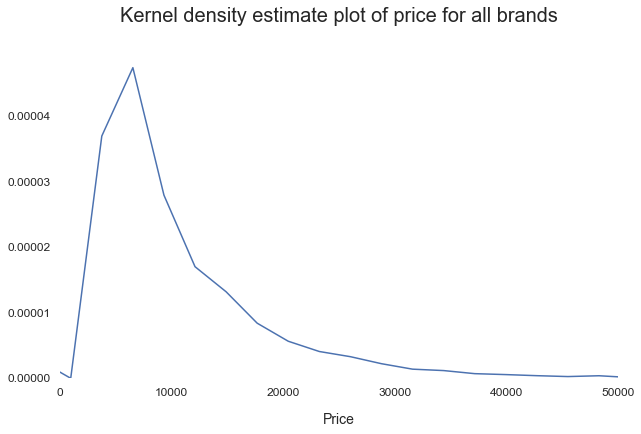

In [21]:
# Plotting the distribution of price for all brands
fig = plt.figure(figsize=(10,6))
sns.set(style = "white")
sns.kdeplot(autos["price"], legend = False)
sns.despine(bottom = True, left = True)
plt.title("Kernel density estimate plot of price for all brands", fontsize = 20, pad = 30)
plt.xlabel("Price", fontsize = 14, labelpad = 15)
plt.xlim(0, 50000) #capped at 50,000 to improve visibility
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
plt.show()

Unsurprisingly given this is a used vehicle site, there is a high proportion of vehicles in the sample that are less than $10,000. Given the proportion of data represented by the top five brands, lets examine these brands specifically.

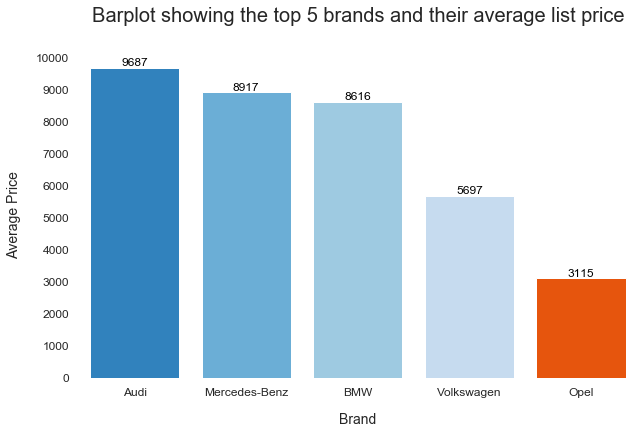

In [22]:
# Plot top five brands
import seaborn as sns
import matplotlib.pyplot as plt
summary_bp_output_top5 = summary_bp_output[0:5].sort_values(by = "average_price", ascending = False)

fig = plt.figure(figsize=(10,6))
sns.set(style = "white")
sns.barplot(x="brand", y = "average_price", data= summary_bp_output_top5, saturation= 1, palette = "tab20c")
plt.title("Barplot showing the top 5 brands and their average list price", fontsize = 20, pad = 30)
plt.xlabel("Brand", fontsize = 14, labelpad = 15)
plt.ylabel("Average Price", fontsize = 14, labelpad = 15)
plt.xticks(np.arange(5), ["Audi", "Mercedes-Benz", "BMW", "Volkswagen", "Opel"], fontsize = 12)
plt.yticks(np.arange(0,10500,1000), fontsize = 12)
sns.despine(bottom = True, left = True)

for index, row in summary_bp_output_top5.reset_index().iterrows():
    plt.text(index, row[4] + 50, str(int(row[4])), ha = "center", color = "black")    
plt.show()

##### ***Top five Brand and price observations***
From the above table and graph:
- German manufacturers represent the top five brands, accounting for 62% of the overall listings. This makes sense as this is a German website.
- Volkswagen is by far the most popular brand, with approximately double the vehicles for sale than the next two brands combined.
- Within the top five common brands, there is large variability (~$10,000) in the more expensive vehicles (i.e., Audi, Mercedes-Benz, BMU). This trend also extends to other expensive brands such as Jaguar, and Porsche.
- For the top five brands, There is a separation between the average price of more expensive brands (i.e., Audi, Mercedes-Benz, BMW) and less expensive brands (i.e., Volkswagen and Opel).

Another key factor in determining whether an individual would purchase a vehicle could be the amount of kilometers put on the vehicle. Let's examine the odometer variable next.

#### ***Brand and odometer and price***

In [23]:
# Examine the odometer(km) category
autos_odo_grouped = (autos.groupby(["odometer(km)"]).size().reset_index().rename(columns ={0:"count"}).sort_values(by = "odometer(km)",
                                                                                                               ascending = False))
autos_odo_grouped["percentage"] = autos_odo_grouped["count"] / len(autos)*100
autos_odo_grouped = autos_odo_grouped.astype({"odometer(km)":"int64","percentage":"int64"}) #round values by converting to int type
autos_odo_grouped

,odometer(km),count,percentage
12,150000,27110,63
11,125000,4550,10
10,100000,1877,4
9,90000,1572,3
8,80000,1298,3
7,70000,1113,2
6,60000,1060,2
5,50000,938,2
4,40000,747,1
3,30000,711,1


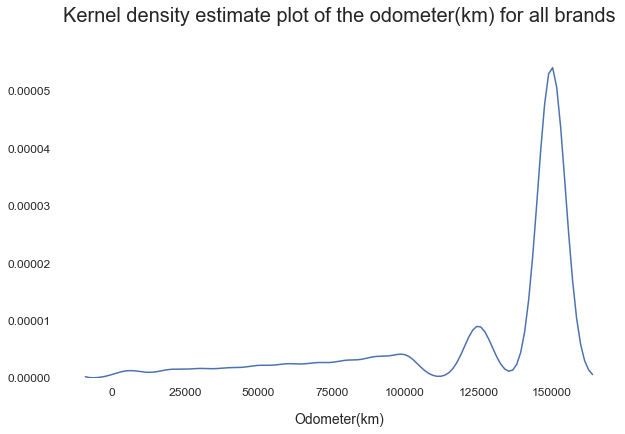

In [24]:
# Plotting the distribution of odometer(km) readings for all brands
fig = plt.figure(figsize=(10,6))
sns.set(style = "white")
sns.kdeplot(autos["odometer(km)"], legend = False)
sns.despine(bottom = True, left = True)
plt.title("Kernel density estimate plot of the odometer(km) for all brands", fontsize = 20, pad = 30)
plt.xlabel("Odometer(km)", fontsize = 14, labelpad = 15)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
plt.show()

##### ***Odometer observations***
From the table and KDE plot above, we can see that the distribution of the odometer(km) readings for all brands is skewed to the left. Interestingly, there seems to be a higher proportion (approximately 64%) of odometer readings around 150,000 km. Given that the average [life expectancy](https://en.wikipedia.org/wiki/Car_longevity) of a vehicle is around 200,000 miles (~321,000 km), one possible explanation is that sellers would like to receive some value for their used vehicle before its expiration date. Another possible reason is that sellers want to upgrade to a new vehicle as they have become dissatisfied with their current vehicle, or the vehicle has started to degrade after 150,000km.

It should be noted that the odometer readings appear to be estimations (i.e., the original categories are rounded), which suggests that the website forces users to pick a range, rather than put the exact number. Let's examine the average odometer readings in the top 5 brands.

In [25]:
# Generate summary table for top five brands
summary_bo_group = autos.groupby(["brand"])[["price", "odometer(km)"]]
summary_bo_output = (summary_bo_group.agg([np.size, np.mean, np.std]).sort_values(
    by = [("price", "size")],ascending = False).reset_index().droplevel(0,axis = 1) # sort by size, drop multi-index
                                         )
summary_bo_output.columns = summary_bo_output.columns = ["brand", "count", "average_price", "standard_deviation(price)", 
                                        "drop1", "average_odometer(km)", "standard_deviation(odometer)"] # rename columns

summary_bo_output.drop("drop1", axis = 1, inplace = True) # drop useless column
summary_bo_output = (summary_bo_output.astype({"average_price":"int64", "standard_deviation(price)":"int64", 
                                               "average_odometer(km)":"int64", "standard_deviation(odometer)": "int64"}))
# Select the top five brands
summary_bo_output_top5 = summary_bo_output[0:5].sort_values("average_odometer(km)", ascending = False).reset_index().drop("index", axis = 1)
summary_bo_output_top5

,brand,count,average_price,standard_deviation(price),average_odometer(km),standard_deviation(odometer)
0,bmw,4791,8616,9416,132557,34308
1,mercedes_benz,4234,8917,10331,130862,35735
2,opel,4533,3115,3686,129106,36898
3,audi,3808,9687,10169,128629,39122
4,volkswagen,8914,5697,6368,128315,38340


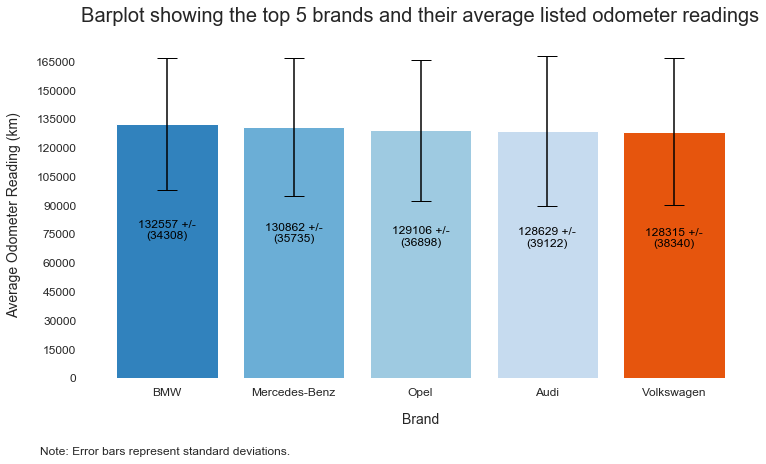

In [26]:
# Plot barplot of odometer readings with error bars.

std = np.array(summary_bo_output_top5["standard_deviation(odometer)"])
fig = plt.figure(figsize = (12,6))
sns.barplot(x="brand", y = "average_odometer(km)", data= summary_bo_output_top5, saturation= 1, palette = "tab20c")
sns.set(style = "white")
sns.despine(left = True, bottom = True)
plt.title("Barplot showing the top 5 brands and their average listed odometer readings", fontsize = 20, pad = 30)
plt.xlabel("Brand", fontsize = 14, labelpad = 15)
plt.xticks(np.arange(5), ["BMW", "Mercedes-Benz", "Opel", "Audi", "Volkswagen"], fontsize = 12)
plt.ylabel("Average Odometer Reading (km)", fontsize = 14, labelpad = 15)
plt.ylim(0, 170000)
plt.yticks(np.arange(0, 170000, 15000),fontsize = 12)
plt.errorbar(x= np.array(summary_bo_output_top5["brand"]), y = np.array(summary_bo_output_top5["average_odometer(km)"]),
             yerr=std, color = "black", capsize = 10, fmt=" ")

for index, row in summary_bo_output_top5.iterrows():
    plt.text(index, row[4] - 60000, str(int(row[4])) + str(" +/-") + ("\n") + str("(") +str(int(row[5])) + str(")"), 
             ha = "center", color = "black", fontsize = 12)
    
plt.text(-1, - 40000 , "Note: Error bars represent standard deviations.", ha = 'left', fontsize = 12)
plt.show()

##### ***Brand and odometer and price observations***
From the table and barplot above:
- There is very little difference in the average odometer readings among the top five brands. BMW and Mercedes-Benz has approximately 3000-4000 kilometers more than Volkswagen and Opel.
- There is very little variation in the average odometer readings among the top five brands. There is slightly less variation among two of the more expensive brands (BMW and Mercedes-Benz) and slightly more variation in the less expensive brands (Volkswagen and Opel).
- The Opel brand on average appears to be not only the cheapest vehicle with an average price of $3115.00, but is also one of the brands with lower odometer readings (average of 129,000KM).

Let's examine the models for each of the top five brands.

#### ***Model and brand***

In [27]:
autos.model.value_counts(normalize = True).head(10) * 100

golf        8.087385
other       7.563640
3er         6.001840
polo        3.508151
corsa       3.468044
passat      3.095289
astra       3.029231
a4          2.849930
c_klasse    2.632883
5er         2.604572
Name: model, dtype: float64

From the table above, the Golf model makes up the highest proportion of models with just over 8%, followed by the other category at approximately 7.5%. Let's examine the models further.

In [28]:
# Examine the model category for all brands
autos_model_grouped = (autos.groupby(["brand", "model"]).size().reset_index().
                       rename(columns=({0:"model_count"})).sort_values(by = "model_count", ascending = False))

autos_model_grouped["percentage_overall"] = autos_model_grouped["model_count"] / len(autos)*100

# Add percentage of brand columns
list1 = []
for index, row in autos_model_grouped.iterrows():
    brand = row[0]
    count = row[2]
    list1.append([index, count / len(autos[autos["brand"] == brand]) * 100])
dataframe = pd.DataFrame(list1).set_index(0)

autos_model_grouped = pd.concat([autos_model_grouped, dataframe.rename(columns=({1:"percentage_brand"}))], axis = 1)
autos_model_grouped = autos_model_grouped.astype({"percentage_overall":"int64", "percentage_brand":"int64"}) # Convert to int to round columns
autos_model_grouped.head(10)

,brand,model,model_count,percentage_overall,percentage_brand
265,volkswagen,golf,3428,8,38
23,bmw,3er,2544,6,53
272,volkswagen,polo,1487,3,16
180,opel,corsa,1470,3,32
270,volkswagen,passat,1312,3,14
177,opel,astra,1284,3,28
13,audi,a4,1208,2,31
139,mercedes_benz,c_klasse,1116,2,26
24,bmw,5er,1104,2,23
142,mercedes_benz,e_klasse,933,2,22


Perhaps unsurprisingly, the first top ten models belong to our top five brands. We can also tell that these models contribute to a large amount of vehicles for that brand. For example, the BMW 3er accounts for 53% of all vehicles for the BMW brand.

Given that the top five brands make up 62% of the data, let's examine the top three models of each top five brand.

In [29]:
# Filter dataset - Top three models for each of the top five brands
autos_model_grouped_top3 = pd.DataFrame()
brands = ["audi", "mercedes_benz", "bmw", "volkswagen", "opel"] #brands of interest
for brand in brands:
    temp = autos_model_grouped[autos_model_grouped["brand"] == brand].sort_values("model_count", ascending = False)
    autos_model_grouped_top3 = pd.concat([autos_model_grouped_top3, temp[0:3]], axis = 0)
autos_model_grouped_top3.groupby(["brand"])["percentage_brand"].sum()

brand
audi             71
bmw              86
mercedes_benz    59
opel             71
volkswagen       68
Name: percentage_brand, dtype: int64

We can see from the table above that the top three models for each of the top five brands accounts for a high proportion of the data for that brand. Mercedes-Benz is the lowest with 60%. 

In [30]:
# Filter dataset - Top four models for each of the top five brands
autos_model_grouped_top4 = pd.DataFrame()
brands = ["audi", "mercedes_benz", "bmw", "volkswagen", "opel"] # brands of interest
for brand in brands:
    temp = autos_model_grouped[autos_model_grouped["brand"] == brand].sort_values("model_count", ascending = False)
    autos_model_grouped_top4 = pd.concat([autos_model_grouped_top4, temp[0:4]], axis = 0)
autos_model_grouped_top4.groupby(["brand"])["percentage_brand"].sum()

brand
audi             76
bmw              92
mercedes_benz    69
opel             79
volkswagen       75
Name: percentage_brand, dtype: int64

In [31]:
autos_model_grouped_top4

,brand,model,model_count,percentage_overall,percentage_brand
13,audi,a4,1208,2,31
12,audi,a3,780,1,20
15,audi,a6,778,1,20
17,audi,other,215,0,5
139,mercedes_benz,c_klasse,1116,2,26
142,mercedes_benz,e_klasse,933,2,22
137,mercedes_benz,a_klasse,499,1,11
147,mercedes_benz,other,430,1,10
23,bmw,3er,2544,6,53
24,bmw,5er,1104,2,23


Including the top four models for each of the top five brands further increases the percentage of listings attributed for that brand, with the minimum now being close to 70%. However, the Mercedes-Benz and Audi brands now contains the "other" category as a model. 

Given this could include a wide range of vehicles, we will continue with analyzing the top three models for each of the top five brands.

#### ***Model, odometer, and price***

In [32]:
# Extract all records with brand and model of interest
brand_model = autos_model_grouped_top3.iloc[:, 0:2] # filter dataset to include dataframe with only brand and models

#obtain raw records from cleaned dataset
autos_bmpo_top5_brand = pd.merge(left = autos[["brand", "model", "price", "odometer(km)", "postal_code"]], right = brand_model, how = "inner")

len(autos_bmpo_top5_brand)

18953

In [33]:
# Create summary table
autos_bmpo_top5_brand_summary_output = autos_bmpo_top5_brand.groupby(["brand", "model"])[["price", "odometer(km)"]].mean().reset_index()
autos_bmpo_top5_brand_summary_output = autos_bmpo_top5_brand_summary_output.rename(columns = {"price": "average_price", 
                                                                                                      "odometer(km)":"average_odometer(km)"})
#Rank the groups for graphs
autos_bmpo_top5_brand_summary_output["order"] = None
autos_bmpo_top5_brand_summary_output.loc[autos_bmpo_top5_brand_summary_output.loc[:,"brand"] == "bmw", "order"] = 5
autos_bmpo_top5_brand_summary_output.loc[autos_bmpo_top5_brand_summary_output.loc[:,"brand"] == "audi", "order"] = 4
autos_bmpo_top5_brand_summary_output.loc[autos_bmpo_top5_brand_summary_output.loc[:,"brand"] == "mercedes_benz", "order"] = 3
autos_bmpo_top5_brand_summary_output.loc[autos_bmpo_top5_brand_summary_output.loc[:,"brand"] == "volkswagen", "order"] = 2
autos_bmpo_top5_brand_summary_output.loc[autos_bmpo_top5_brand_summary_output.loc[:,"brand"] == "opel", "order"] = 1
autos_bmpo_top5_brand_summary_output = autos_bmpo_top5_brand_summary_output.sort_values(["order", "average_price"], 
                                                                                        ascending = False).reset_index().drop("index", axis = 1)
autos_bmpo_top5_brand_summary_output

,brand,model,average_price,average_odometer(km),order
0,bmw,1er,11551.393638,107365.805169,5
1,bmw,5er,8114.523551,140923.913043,5
2,bmw,3er,6112.952044,137637.578616,5
3,audi,a6,8770.805913,140751.928021,4
4,audi,a3,8232.935897,122743.589744,4
5,audi,a4,7136.235927,136022.350993,4
6,mercedes_benz,e_klasse,8208.655949,136977.491961,3
7,mercedes_benz,c_klasse,7135.110215,129681.899642,3
8,mercedes_benz,a_klasse,4200.557114,128507.014028,3
9,volkswagen,golf,5272.417153,127380.396733,2


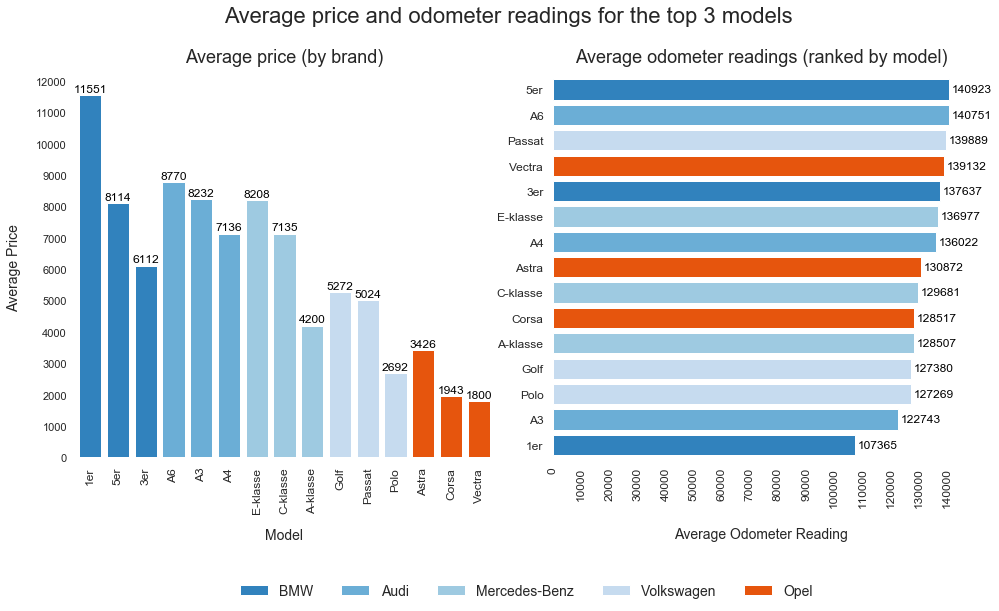

In [34]:
# Create barplot of the average price of the top three models for each brand
fig = plt.figure(figsize =(16,7))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)

sns.set(style = "white")
sns.despine(left = True, bottom = True)

plt.suptitle("Average price and odometer readings for the top 3 models", fontsize= 22, x = 0.5, y = 1.02)

sns.barplot(x = "model", y = "average_price", hue = "brand", dodge = False, ax = ax1, data = autos_bmpo_top5_brand_summary_output, 
            saturation = 1, palette = "tab20c")

ax1.set_title("Average price (by brand)", fontsize = 18, pad = 15)

x_tick_labels = autos_bmpo_top5_brand_summary_output["model"].str.replace("_","-").str.capitalize()
# ['1er', '5er', '3er', 'A6', 'A3', 'A4', 'E klasse', 'C klasse', 'A klasse', 'Golf', 'Passat', 'Polo', 'Astra', 'Corsa', 'Vectra']
ax1.set_xlabel("Model", fontsize = 14, labelpad = 15)
ax1.set_xticklabels(x_tick_labels, fontsize = 12, rotation = 90)

ax1.set_ylabel("Average Price", fontsize = 14, labelpad = 15)
ax1.set_yticks(np.arange(0, 13000, 1000))

labels_legend = ["BMW", "Audi", "Mercedes-Benz", "Volkswagen","Opel"]

h, l = ax1.get_legend_handles_labels()
ax1.legend(h,labels_legend,edgecolor = "None", ncol = 5, bbox_to_anchor=(1.8, -0.3), fontsize = 14)

#add price labels
for index, row in autos_bmpo_top5_brand_summary_output.iterrows():
    ax1.text(index, (row[2] + 100), str(int(row[2])), ha = "center", color = "black", fontsize = 12)

#Odometer Plot 
order_bars = autos_bmpo_top5_brand_summary_output.sort_values("average_odometer(km)", ascending = False).model.to_list()
sns.barplot(x = "average_odometer(km)", y = "model", order = order_bars, hue = "brand", dodge = False, ax = ax2, 
            data = autos_bmpo_top5_brand_summary_output, saturation = 1, palette = "tab20c")

ax2.set_title("Average odometer readings (ranked by model)", fontsize = 18, pad = 15)

ax2.set_xlabel("Average Odometer Reading", fontsize = 14, labelpad = 20)
for label in ax2.get_xticklabels():
    label.set_fontsize(12)
    label.set_rotation(90)
ax2.set_xticks(np.arange(0, 150000, 10000))

y_tick_labels = (autos_bmpo_top5_brand_summary_output.sort_values("average_odometer(km)", ascending = False)["model"].str.replace("_","-").str.capitalize())
ax2.set_yticklabels(y_tick_labels, fontsize = 12)
ax2.set_ylabel("")

ax2.legend().remove()

#add odometer labels
for index, row in autos_bmpo_top5_brand_summary_output.sort_values("average_odometer(km)", ascending = False).reset_index().iterrows():
    ax2.text((row[4] + 1000), index, str(int(row[4])), va = "center", color = "black", fontsize = 12)

plt.subplots_adjust(wspace = 0.145)
plt.show()

##### ***Model and odometer and price observations***
Based on the table and graph above:
- Of the more expensive brands, the BMU has the most expensive model with the 1er, followed by the Audi A6 and the Mercedes-Benz E-klasse.
- There is more variability in the average odometer readings when examining the top three models of each top five brand, than examining the overall brand trends. Half of the models show an approximate 6,000km difference from eachother.
- The BMU 1er has the lowest odometer readings of all models with an average of approximately 107,365km, followed by the Audi A3 with 122,743km, and the Volkswagen Polo with 127,269km. Given the purpose is to select three candidates, we will select the following:
 - Assuming that kilometers traveled is a good proxy for vehicle quality (see limitations below), it appears that the best vehicle for the best price is the Opel Corsa as it is nearly the cheapest vehicle (behind the Opel Vectra) and has the lowest mileage of the three cheapest vehicles. 
 - While the Opel Vectra has approximately 9,000km more than the Opel Astra, the Opel Astra is nearly twice as expensive as the Opel Vectra. The argument for quality can be made depending if an individual considers price to be more important than odometer readings or vice-versa. Given the there are 1284 Astras and 507 Vectras in our sample, the Opel Astra will be our second candidate due to being potentially more representative than the Opel Vectra.
 - Lastly, the Volkswagen Polo has the third lowest mileage with an average of 127,269km, as well as being the third cheapest vehicle. This will be our third candidate.

We will proceed with identifying the best places to look for our top candidate models.

#### ***Geographical analysis***

It might be of interest to potential buyers where to travel to view the candidate vehicles. Given that a person might view several vehicles a day before making a decision, let's examine which locations have the most ads placed for our candidate vehicles. The following sources were used to create the map:
- A map of Germany was obtained from the this [site](https://www.suche-postleitzahl.org/plz-karte-erstellen) in geoJSON format. 
 - Originally, an accuracy of high, and territory of five was used. After plotting data (including aggregating the data from postal code to area level), the map was still too detailed for the purposes of this analysis and load times were too high. Therefore, the map with an **accuracy of medium** and **territory of two** was used.
- Using [Wikipedia](https://en.wikipedia.org/wiki/List_of_postal_codes_in_Germany), the region numbers (which is similar to the Canadian FSA) were mapped to the used vehicles dataset, and was subsequently joined to the geoJSON file.

In [35]:
# Import packages
import geopandas
import folium

In [36]:
# Create postal code dataframe containing only the top 3 models
postal_codes = autos_bmpo_top5_brand.loc[:, ["postal_code", "model"]].reset_index().drop("index", axis = 1)
postal_codes = postal_codes[postal_codes.model.str.contains("corsa|astra|polo")] # select top 3 models
postal_codes["region"] = postal_codes.postal_code.astype("str").str.zfill(5).str[0:2] #pad 0s and create region column to match with json.

# Add a count column - count number of regions per model
postal_codes = postal_codes.groupby(["model", "region"]).size().reset_index().rename(columns=({0:"Model Count", "region":"plz"}))
postal_codes = postal_codes.iloc[:, [1,0,2]] # re order columns

# Clean Wikipedia dataset (saved into an csv file with encoding Windows-1252/WinLatin1)

region_map = pd.read_csv("region_map2.csv", encoding = "latin-1", dtype = {'Region #': "str"})
region_map["Region #"] = region_map["Region #"].str.strip()
region_map["Area"] = region_map["Area"].str.split(",").str[0]
region_map["Area"] = region_map["Area"].str.strip()

# Merge with used vehicles dataset
postal_codes = pd.merge(left = postal_codes, right = region_map, left_on = "plz", right_on = "Region #", how = "left").drop("Region #", 
                                                                                                                            axis = 1)
# Check for nulls
print(postal_codes.isnull().sum()) # no null values

plz            0
model          0
Model Count    0
Area           0
dtype: int64


In [37]:
# Read json into geopandas dataframe
geopandas_germany = geopandas.read_file("germany_2.geojson")
geo_germany_merge = geopandas_germany.merge(postal_codes, on = "plz", how = "left") # add counts and area name into geopandas dataframe

# Create separate geopandas dataframes for each candidate vehicle
corsa = geo_germany_merge[geo_germany_merge.model == "corsa"]
astra = geo_germany_merge[geo_germany_merge.model == "astra"]
polo = geo_germany_merge[geo_germany_merge.model == "polo"]

In [38]:
# Create choropleth map that shows areas with the most models
m = folium.Map(location=[52.520008, 13.404954], zoom_start=5)

# Corsa
corsa_geo = folium.Choropleth(
    geo_data = corsa,
    name='Corsa',
    data = corsa,
    columns=["plz", "Model Count"],
    key_on='feature.properties.plz',
    fill_color="OrRd",
    highlight = True,
    nan_fill_color='white',
    fill_opacity=0.7,
    line_opacity=0.3,
    show = True,
 ).add_to(m)

corsa_geo.geojson.add_child(
    folium.features.GeoJsonTooltip(["Model Count", "Area"]))

# Astra
astra_geo = folium.Choropleth(
    geo_data = astra,
    name='Astra',
    data = astra,
    columns=["plz", "Model Count"],
    key_on='feature.properties.plz',
    fill_color="BuGn",
    highlight = True,
    nan_fill_color='white',
    fill_opacity=0.7,
    line_opacity=0.3,
    show = False
 ).add_to(m)

astra_geo.geojson.add_child(
    folium.features.GeoJsonTooltip(["Model Count", "Area"]))

# Polo
polo_geo = folium.Choropleth(
    geo_data = polo,
    name='Polo',
    data = polo,
    columns=["plz", "Model Count"],
    key_on='feature.properties.plz',
    fill_color="PuBu",
    highlight = True,
    nan_fill_color='white',
    fill_opacity=0.7,
    line_opacity=0.3,
    show = False
 ).add_to(m)

polo_geo.geojson.add_child(
    folium.features.GeoJsonTooltip(["Model Count", "Area"]))

folium.LayerControl(position='topright', collapsed=False).add_to(m)

m

##### ***Geographical observations***
Based on the map above, our top three candidate models appear to be more popular in Western Germany. In particular, potential areas that could be considered when deciding to buy the candidate models are:
- Oldenburg, which has a high proportion of all three candidate vehicles. Additional locations could be:
 - For the Corsa - Essen, Dortmund, and Wiesbaden;
 - For the Astra - Dortmund, Wiesbaden; and
 - For the Polo - Braunschweig, Hagen

### **Conclusions**

Based on the above analysis:
- There is little variability between the odometer readings of all vehicles. This could suggest that the wear and tear on the listed vehicles is comparable.
- There is potential options in the Opel Corsa, Opel Astra, and Volkswagen Polo that maximum price and mileage. 
- There are several locations in which these three models could be purchased in Western Germany, notably in Oldenburg.

### **Limitations/Future Analysis**

There are several and potentially crippling limitations:
- This analysis only considers price and mileage as indicators of quality. There are potential other factors such as ```yearOfRegistration``` that this analysis did not consider. Future analysis could incorporate this variable.
- The ```notRepairedDamage``` variable is a potential limiting factor. Vehicles with major damage (i.e., sold for parts) would be sold for much less than vehicles that are still operational. Research into the range (i.e., minor damage to major damage) that this variable could take on is required in order to remove vehicles that have major damage from future analyses.
- The final sample for this analysis was approximately 19,000. This analysis should be repeated on the original sample of 370,000 to determine if the findings hold.